In [19]:
import pyreadr

In [45]:
from sklearn.ensemble import AdaBoostRegressor
from sklearn.tree import DecisionTreeRegressor

from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.preprocessing import StandardScaler #Importing the StandardScaler

from math import sqrt
from scipy.stats.stats import pearsonr

import matplotlib.pyplot as plt
import seaborn as sns

from scipy.stats.stats import pearsonr

#Geo plotting libraries
import geopandas as gdp
from matplotlib.colors import ListedColormap
# import geoplot as glpt



In [20]:
result = pyreadr.read_r('India_AQI/Imputed_predicted_spatial_0918_monthly.rds') # also works for RData
india_df1 = result[None]

In [21]:
india_df1.to_csv('india_pollution.csv', index=False)

In [22]:
india_df1.columns
#india_df1.shape

Index(['long', 'lat', 'year.x', 'Month', 'DB', 'Combined', 'PS', 'T2M', 'U10M',
       'V10M', 'QV2M', 'TPRECMAX', 'TQV', 'OCSMASS', 'SO2SMASS', 'SO4SMASS',
       'BCSMASS', 'SSSMASS25', 'DUSMASS25', 'DUEXTT25', 'PBLH', 'AAI',
       'ColumnAmountNO2Trop2_monthly', 'NDVI_monthly', 'fire_point',
       'all_road_density', 'hw_density', 'mr_density', 'hw_mr_den',
       'Elevation', 'Population_density', 'predicted_PM'],
      dtype='object')

In [23]:
target_col_india1 = ['predicted_PM']

india_df1_target = india_df1[target_col_india1] 
india_df1_train = india_df1.drop(target_col_india1, axis = 1)

# india_df1_train.shape
india_df1_train.columns


Index(['long', 'lat', 'year.x', 'Month', 'DB', 'Combined', 'PS', 'T2M', 'U10M',
       'V10M', 'QV2M', 'TPRECMAX', 'TQV', 'OCSMASS', 'SO2SMASS', 'SO4SMASS',
       'BCSMASS', 'SSSMASS25', 'DUSMASS25', 'DUEXTT25', 'PBLH', 'AAI',
       'ColumnAmountNO2Trop2_monthly', 'NDVI_monthly', 'fire_point',
       'all_road_density', 'hw_density', 'mr_density', 'hw_mr_den',
       'Elevation', 'Population_density'],
      dtype='object')

In [24]:
result_2 = pyreadr.read_r('India_AQI/Data_to_Liu/dataset_modelling_v9.rds') # also works for RData
india_df2 = result_2[None]
india_df2.columns

Index(['lat', 'long', 'DOY', 'year.x', 'gid', 'DB', 'Combined', 'PS', 'T2M',
       'U10M', 'V10M', 'QV2M', 'TPRECMAX', 'TQV', 'OCSMASS', 'SO2SMASS',
       'SO4SMASS', 'BCSMASS', 'SSSMASS25', 'DUSMASS25', 'DUEXTT25', 'PBLH',
       'AAI', 'ColumnAmountNO2Trop2_monthly', 'Month', 'NDVI_monthly',
       'fire_point', 'all_road_density', 'hw_density', 'mr_density',
       'hw_mr_den', 'Elevation', 'Population_density', 'PM_mean', 'N_station'],
      dtype='object')

In [25]:
print(india_df_2.shape)

target_col_india = ['PM_mean']

india_df2_target = india_df2[target_col_india] 

unnec_cols = ['DOY', 'gid', 'PM_mean', 'N_station']
india_df2_train = india_df2.drop(unnec_cols, axis = 1)
india_df2_train.shape
india_df2_train.columns

(56834, 31)


Index(['lat', 'long', 'year.x', 'DB', 'Combined', 'PS', 'T2M', 'U10M', 'V10M',
       'QV2M', 'TPRECMAX', 'TQV', 'OCSMASS', 'SO2SMASS', 'SO4SMASS', 'BCSMASS',
       'SSSMASS25', 'DUSMASS25', 'DUEXTT25', 'PBLH', 'AAI',
       'ColumnAmountNO2Trop2_monthly', 'Month', 'NDVI_monthly', 'fire_point',
       'all_road_density', 'hw_density', 'mr_density', 'hw_mr_den',
       'Elevation', 'Population_density'],
      dtype='object')

In [26]:
india_df2_train = india_df2_train[['long', 'lat', 'year.x', 'Month', 'DB', 'Combined', 'PS', 'T2M', 'U10M',
       'V10M', 'QV2M', 'TPRECMAX', 'TQV', 'OCSMASS', 'SO2SMASS', 'SO4SMASS',
       'BCSMASS', 'SSSMASS25', 'DUSMASS25', 'DUEXTT25', 'PBLH', 'AAI',
       'ColumnAmountNO2Trop2_monthly', 'NDVI_monthly', 'fire_point',
       'all_road_density', 'hw_density', 'mr_density', 'hw_mr_den',
       'Elevation', 'Population_density']]
                        
india_df2_train         

,long,lat,year.x,Month,DB,Combined,PS,T2M,U10M,V10M,...,AAI,ColumnAmountNO2Trop2_monthly,NDVI_monthly,fire_point,all_road_density,hw_density,mr_density,hw_mr_den,Elevation,Population_density
0,77.35,28.65,2015.0,1.0,NaN,NaN,99218.785550,289.172735,0.608774,-0.951816,...,-0.067603,3.591544e+06,0.26120,0,3461.895,0.0,280.402,280.402,205.507847,14109.076389
1,77.35,28.65,2015.0,1.0,NaN,NaN,99312.279076,288.604989,-0.176253,0.694982,...,-0.067603,3.591544e+06,0.26120,0,3461.895,0.0,280.402,280.402,205.507847,14109.076389
2,77.35,28.65,2015.0,1.0,NaN,NaN,99297.302237,287.406983,1.356144,-0.821515,...,-0.067603,3.591544e+06,0.26120,0,3461.895,0.0,280.402,280.402,205.507847,14109.076389
3,77.35,28.65,2015.0,1.0,0.6540,NaN,99375.666579,286.070121,3.513530,-2.108626,...,-0.067603,3.591544e+06,0.26120,0,3461.895,0.0,280.402,280.402,205.507847,14109.076389
4,77.35,28.65,2015.0,1.0,0.3655,NaN,99044.251665,286.232250,5.075480,-2.156899,...,-0.067603,3.591544e+06,0.26120,0,3461.895,0.0,280.402,280.402,205.507847,14109.076389
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56829,75.85,30.95,2018.0,12.0,0.7240,0.6300,99023.804748,283.536678,1.737618,-2.197118,...,0.116226,4.545660e+06,0.49805,0,3447.333,0.0,117.436,117.436,237.994691,4828.318866
56830,76.55,31.05,2018.0,12.0,0.3770,0.4295,94548.653520,283.874124,0.735115,-2.174149,...,0.009375,4.464983e+06,0.49095,0,211.019,0.0,82.393,82.393,280.996775,467.474151
56831,75.55,31.35,2018.0,12.0,0.7100,0.6280,98901.813883,283.329715,2.062161,-1.694241,...,0.089646,4.589831e+06,0.39940,0,362.872,0.0,197.795,197.795,235.664684,4177.347415
56832,74.85,31.65,2018.0,12.0,0.7500,0.7370,99397.680441,283.744416,2.248381,-1.071401,...,0.088959,4.273421e+06,0.36120,0,909.232,0.0,248.575,248.575,227.415926,6657.425154


In [33]:
india_df2_train = india_df2_train.fillna(india_df2_train.mean())
india_df2_train

,long,lat,year.x,Month,DB,Combined,PS,T2M,U10M,V10M,...,AAI,ColumnAmountNO2Trop2_monthly,NDVI_monthly,fire_point,all_road_density,hw_density,mr_density,hw_mr_den,Elevation,Population_density
0,77.35,28.65,2015.0,1.0,0.620498,0.594043,99218.785550,289.172735,0.608774,-0.951816,...,-0.067603,3.591544e+06,0.26120,0,3461.895,0.0,280.402,280.402,205.507847,14109.076389
1,77.35,28.65,2015.0,1.0,0.620498,0.594043,99312.279076,288.604989,-0.176253,0.694982,...,-0.067603,3.591544e+06,0.26120,0,3461.895,0.0,280.402,280.402,205.507847,14109.076389
2,77.35,28.65,2015.0,1.0,0.620498,0.594043,99297.302237,287.406983,1.356144,-0.821515,...,-0.067603,3.591544e+06,0.26120,0,3461.895,0.0,280.402,280.402,205.507847,14109.076389
3,77.35,28.65,2015.0,1.0,0.654000,0.594043,99375.666579,286.070121,3.513530,-2.108626,...,-0.067603,3.591544e+06,0.26120,0,3461.895,0.0,280.402,280.402,205.507847,14109.076389
4,77.35,28.65,2015.0,1.0,0.365500,0.594043,99044.251665,286.232250,5.075480,-2.156899,...,-0.067603,3.591544e+06,0.26120,0,3461.895,0.0,280.402,280.402,205.507847,14109.076389
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56829,75.85,30.95,2018.0,12.0,0.724000,0.630000,99023.804748,283.536678,1.737618,-2.197118,...,0.116226,4.545660e+06,0.49805,0,3447.333,0.0,117.436,117.436,237.994691,4828.318866
56830,76.55,31.05,2018.0,12.0,0.377000,0.429500,94548.653520,283.874124,0.735115,-2.174149,...,0.009375,4.464983e+06,0.49095,0,211.019,0.0,82.393,82.393,280.996775,467.474151
56831,75.55,31.35,2018.0,12.0,0.710000,0.628000,98901.813883,283.329715,2.062161,-1.694241,...,0.089646,4.589831e+06,0.39940,0,362.872,0.0,197.795,197.795,235.664684,4177.347415
56832,74.85,31.65,2018.0,12.0,0.750000,0.737000,99397.680441,283.744416,2.248381,-1.071401,...,0.088959,4.273421e+06,0.36120,0,909.232,0.0,248.575,248.575,227.415926,6657.425154


In [34]:
model_Ada_india = AdaBoostRegressor(DecisionTreeRegressor(max_depth = 8), learning_rate=0.01, n_estimators=500) 
model_Ada_india.fit(india_df2_train, india_df2_target)

y_pred_Ada_india = model_Ada_india.predict(india_df1_train)


/Users/shrey/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:73: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


NameError: name 'sqrt' is not defined

In [40]:
mse_Ada_india = sqrt(mean_squared_error(india_df1_target, y_pred_Ada_india))
print("RMSE of Adaboost.R2:", mse_Ada_india)

r2_score1_Ada_india = r2_score(india_df1_target, y_pred_Ada_india)
print("R^2 (Type 1) of AdaboostR2:", r2_score1_Ada_india)

r2_score2_Ada_india = pearsonr(india_df1_target, y_pred_Ada_india)
r2_score2_Ada_india = (r2_score2_Ada_india[0])**2
print("R^2 (Type 2) of AdaboostR2:", r2_score2_Ada_india)

RMSE of Adaboost.R2: 28.184749841909447
R^2 (Type 1) of AdaboostR2: 0.35240417698125204


TypeError: No loop matching the specified signature and casting was found for ufunc add

In [49]:
# Importing required Libraries for Plotting the Map

import geopandas as gpd
import json
import altair as alt
import pandas as pd

from os import listdir
from os.path import isfile, join
import glob

import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib import cm
import seaborn as sns

In [50]:
gdf_india = gpd.read_file('India_AQI/maps-master/Districts/Census_2011/2011_Dist.shp')
gdf_india

,DISTRICT,ST_NM,ST_CEN_CD,DT_CEN_CD,censuscode,geometry
0,Adilabad,Andhra Pradesh,28,1,532,"POLYGON ((78.84972 19.76010, 78.85102 19.75945..."
1,Agra,Uttar Pradesh,9,15,146,"POLYGON ((78.19803 27.40280, 78.19804 27.40278..."
2,Ahmadabad,Gujarat,24,7,474,"MULTIPOLYGON (((72.03456 23.50527, 72.03337 23..."
3,Ahmadnagar,Maharashtra,27,26,522,"POLYGON ((74.67333 19.94670, 74.67393 19.93509..."
4,Aizawl,Mizoram,15,3,283,"POLYGON ((92.98749 24.40453, 92.99107 24.40236..."
...,...,...,...,...,...,...
636,Tapi,Gujarat,24,26,493,"POLYGON ((74.08573 21.55513, 74.08672 21.55515..."
637,Nicobar,Andaman & Nicobar Island,35,1,638,"MULTIPOLYGON (((93.84861 7.24051, 93.84870 7.2..."
638,South Andaman,Andaman & Nicobar Island,35,3,640,"MULTIPOLYGON (((92.69758 12.23961, 92.69778 12..."
639,North & Middle Andaman,Andaman & Nicobar Island,35,2,639,"MULTIPOLYGON (((92.89905 12.91512, 92.89905 12..."


In [51]:
## Import the geodata for the rivers in India
gdf_india_river = gpd.read_file('India_AQI/tl_2016_12061_edges/tl_2016_12061_edges.shp')
#gdf_india_river

In [52]:
gdf_india_boundary = gpd.read_file('India_AQI/maps-master/Survey-of-India-Index-Maps/IndiaBoundary/IndiaBoundary.shp')

gdf_india_states = gpd.read_file('India_AQI/maps-master/Survey-of-India-Index-Maps/Boundaries/India-States.shp')

gdf_india_districts = gpd.read_file('India_AQI/maps-master/Survey-of-India-Index-Maps/Boundaries/India-Districts-2011Census.shp')

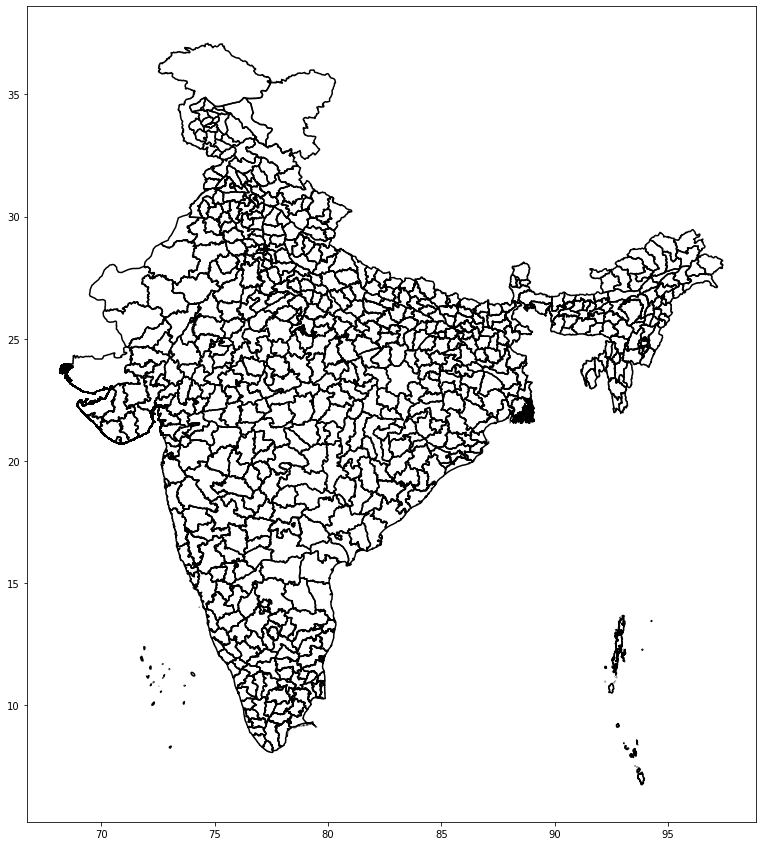

In [53]:
#### Try the map plots here!!!! ######################
fig, axs = plt.subplots(figsize = (15, 15))
gdf_india_districts.plot(ax = axs, facecolor="none", edgecolor = "black", linewidth = 1.5)

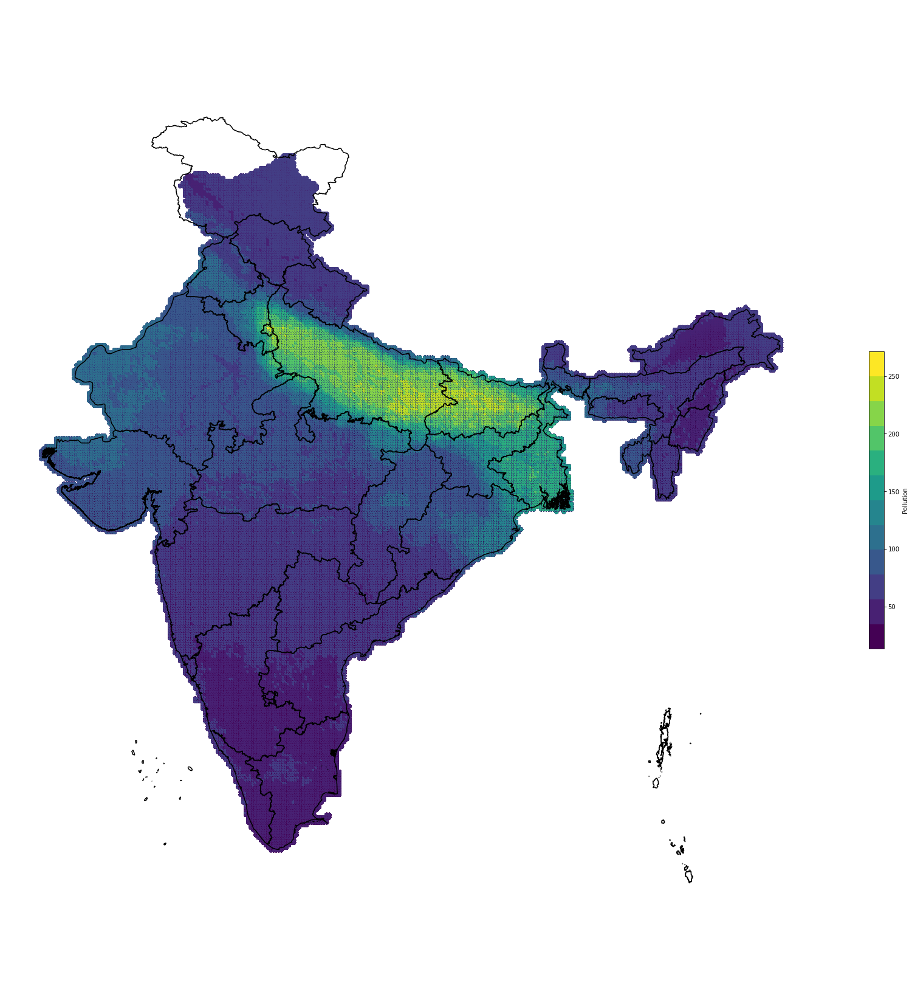

In [98]:
fig, axs = plt.subplots(figsize = (30, 30))

rainbow_colors = ListedColormap(['#0000ff', '#0054ff', '#00abff', '#00ffff', '#54ffab', '#abff53', '#ffff00', '#ffaa00', '#ff5400', '#ff0000']) #Using VIBGYOR for colors
viridis = cm.get_cmap('viridis', 12)

india_map = gpd.GeoDataFrame(india_df, geometry = gpd.points_from_xy(india_df.long, india_df.lat)) #Create a geodataframe
india_map.plot(column = 'predicted_PM', ax = axs, cmap = viridis, legend = True, 
               legend_kwds={'label': "Pollution", 'shrink': 0.3}) #Plot the geodatframe

#cmap = rainbow_colors
#'orientation': "horizontal"

gdf_india_states.plot(ax = axs, facecolor="none", edgecolor = "black", linewidth = 1.5) #Create a plot for the India boundary


# gdf_india_boundary.plot(ax = axs, facecolor="none", edgecolor = "black", linewidth = 1.5) #Create a plot for the India boundary
# gdf_india_states.plot(ax = axs, facecolor="none", edgecolor = "black", linewidth = 1.5) #Create a plot for the India states
# gdf_india_districts.plot(ax = axs, facecolor="none", edgecolor = "black", linewidth = 0.3) #Create a plot for the India districts


axs.axis('off') # 4
plt.axis('equal') # 5

plt.show()

In [54]:
y_pred_Ada_india


array([127.6579642 , 118.72396658,  89.48860465, ...,  82.14517249,
        87.31643067,  85.96666667])

In [55]:
predicted_india_df = india_df1[['long', 'lat']].copy()
predicted_india_df['Pred_PM'] = y_pred_Ada_india.tolist()
predicted_india_df

,long,lat,Pred_PM
0,68.15,23.55,127.657964
1,68.15,23.55,118.723967
2,68.15,23.55,89.488605
3,68.15,23.55,86.289374
4,68.15,23.55,74.458596
...,...,...,...
3536995,97.45,28.25,69.733257
3536996,97.45,28.25,70.316864
3536997,97.45,28.25,82.145172
3536998,97.45,28.25,87.316431


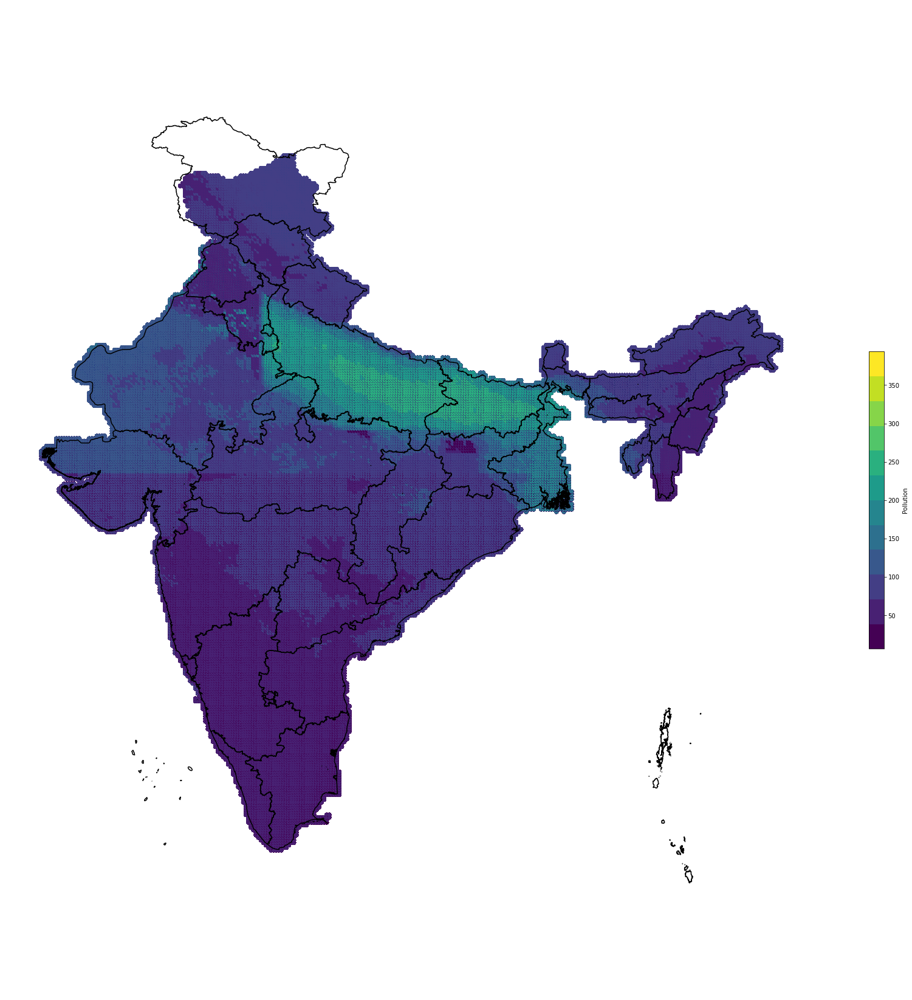

In [56]:
fig, axs = plt.subplots(figsize = (30, 30))

rainbow_colors = ListedColormap(['#0000ff', '#0054ff', '#00abff', '#00ffff', '#54ffab', '#abff53', '#ffff00', '#ffaa00', '#ff5400', '#ff0000']) #Using VIBGYOR for colors
viridis = cm.get_cmap('viridis', 12)

india_map = gpd.GeoDataFrame(predicted_india_df, geometry = gpd.points_from_xy(predicted_india_df.long, predicted_india_df.lat)) #Create a geodataframe
india_map.plot(column = 'Pred_PM', ax = axs, cmap = viridis, legend = True, 
               legend_kwds={'label': "Pollution", 'shrink': 0.3}) #Plot the geodatframe

#cmap = rainbow_colors
#'orientation': "horizontal"

gdf_india_states.plot(ax = axs, facecolor="none", edgecolor = "black", linewidth = 1.5) #Create a plot for the India boundary


# gdf_india_boundary.plot(ax = axs, facecolor="none", edgecolor = "black", linewidth = 1.5) #Create a plot for the India boundary
# gdf_india_states.plot(ax = axs, facecolor="none", edgecolor = "black", linewidth = 1.5) #Create a plot for the India states
# gdf_india_districts.plot(ax = axs, facecolor="none", edgecolor = "black", linewidth = 0.3) #Create a plot for the India districts


axs.axis('off') # 4
plt.axis('equal') # 5

plt.show()

In [14]:
# Creating configs for color,selection,hovering
multi = alt.selection_multi(fields=['ST_CEN_CD','ST_NM'], bind='legend')
color = alt.condition(multi,
                  alt.Color('ST_CEN_CD', type='ordinal',
                  scale=alt.Scale(scheme='yellowgreenblue')),
                  alt.value('lightgray'))
hover = alt.selection(type='single', on='mouseover', nearest=True,
                      fields=['x', 'y'])

#Creating an altair map layer
choro = alt.Chart(gdf).mark_geoshape(
    stroke='black'
).encode( 
    color=color, 
    tooltip=['state','count']
).add_selection(
        multi
    ).properties( 
    width=650,
    height=800
)
# Legend
c1 = alt.layer(choro).configure_legend(
    orient = 'bottom-right',
    direction = 'horizontal',
    padding = 10,
    rowPadding = 15
)
#Adding Labels
labels = alt.Chart(gdf).mark_text().encode(
    longitude ='x',
    latitude ='y',
    text ='count',
    size =alt.value(8),
    opacity=alt.value(0.6)
)
c2 = alt.Chart(gdf).mark_geoshape(
    stroke='black'
).encode( 
    color=color, 
    tooltip=['state','count']
).add_selection(
        hover
    ).project(
    scale=100, 
)
(c1+labels).configure_view(strokeWidth=0)

ValueError: state encoding field is specified without a type; the type cannot be inferred because it does not match any column in the data.

alt.LayerChart(...)

In [15]:
alt.Chart(gdf).mark_geoshape().encode(
    color='rate:Q'
).properties(
    width=500,
    height=300
)

alt.Chart(...)